In [3]:
%load_ext autoreload
%autoreload 2
from Utils import loadImages, show_images, getFakeImage, printStats, imageFlow
from Model import Discriminator, Generator, weights_init, getCriterion, getFixedNoise, getOptimizer, train_generator, train_discriminator, loadG

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


Number of images:  8683


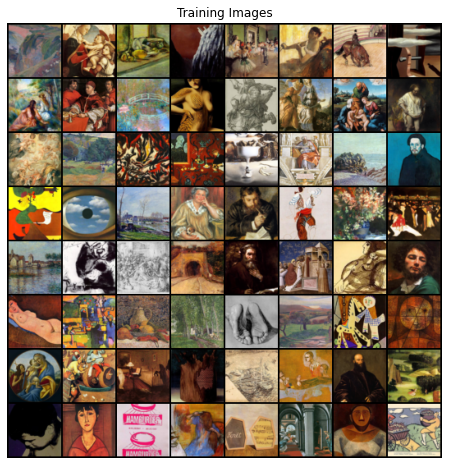

In [5]:
dataloader, device = loadImages('images/')

In [8]:
# Create the generator
netG = Generator().to(device)

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.02.
netG.apply(weights_init)

# Print the model
print(netG)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(128, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


In [25]:
# Create the Discriminator
netD = Discriminator().to(device)

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netD.apply(weights_init)

# Print the model
print(netD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): LeakyReLU(negative_slope=0.2, inplace=True)
    (3): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): LeakyReLU(negative_slope=0.2, inplace=True)
    (6): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): LeakyReLU(negative_slope=0.2, inplace=True)
    (9): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): LeakyReLU(negative_slope=0.2, inplace=True)
    (12): Conv2d(512, 1, kernel_size=(

In [26]:
# Initialize BCELoss function
criterion = getCriterion()

# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
fixed_noise = getFixedNoise(device)

# Setup Adam optimizers for both G and D
optimizerD = getOptimizer(netD.parameters())
optimizerG = getOptimizer(netG.parameters())

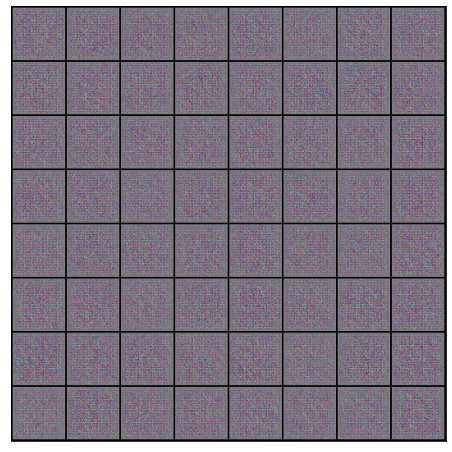

In [27]:
fake_images = netG(fixed_noise)
show_images(fake_images.detach().cpu())

In [29]:
import torch

img_list = []
def fit(epochs, lr, start_idx=1):
  print("Init Training")
  torch.cuda.empty_cache()
  loss_g, loss_d = None, None
  for epoch in range(epochs):
    for _ , real_images in enumerate(dataloader, 0):
      # Train discriminator
      real_images = real_images[0].to(device)
      loss_d = train_discriminator(real_images, optimizerD, netG, netD, device)
      # Train generator
      loss_g = train_generator(optimizerG, device, netG, netD)
    printStats(epoch, epochs, loss_g, loss_d)
    if epochs % 20 == 0:
      fake_images = getFakeImage(netG, fixed_noise)
      img_list.append(fake_images)

lr = 0.0002
epochs = 50
fit(epochs, lr)
# Save the model checkpoints
torch.save(netG.state_dict(), 'G.pth')
torch.save(netD.state_dict(), 'D.pth')

Init Training


Animation size has reached 20982660 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


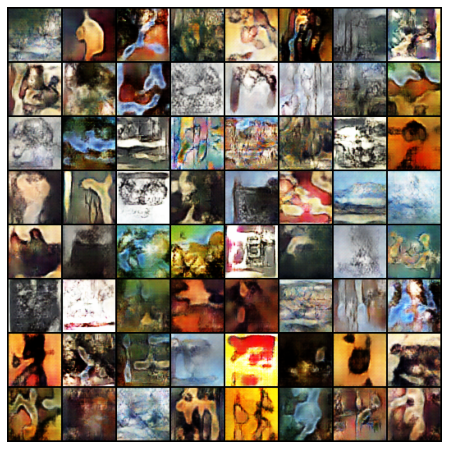

In [43]:
from IPython.display import HTML
ani = imageFlow(img_list)
HTML(ani.to_jshtml())